In [1]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from mpl_toolkits import mplot3d

In [2]:
from scipy.constants import speed_of_light, elementary_charge, electron_mass, hbar

me_SI = electron_mass
hbar_SI = hbar   
e_SI = elementary_charge
c_SI = speed_of_light

meV = e_SI * 1e-3
nm = 1e-9
ps = 1e-12

c = c_SI * ps / nm           
hbar_meV_ps = hbar_SI / (meV * ps)  
me = me_SI * c_SI ** 2 / meV / c ** 2    

hbar = hbar_meV_ps
m = me
omega = 2 / hbar
vQD = 15

x_min, x_max = -75, 150
y_min, y_max = -75, 150
x0, y0 = 0, 0
x1, y1 = 75, 75
dx = x1 - x0
dy = y1 - y0

t1 = 2
dist = np.sqrt(dx ** 2 + dy ** 2)
t2 = t1 + dist / vQD

t_min = t1
t_max = t2

In [3]:
if torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Using MPS backend for Apple GPU acceleration!")
elif torch.cuda.is_available():
    device = torch.device("cuda")
    print("Using cuda")
else:
    device = torch.device("cpu")
    print("Using CPU instead.")

Using cuda


In [4]:
class PINN(nn.Module):
    def __init__(self, layers, t_min, t_max):
        super(PINN, self).__init__()
        self.hidden_layers = nn.ModuleList()
        
        for units in layers[1:-1]:
            self.hidden_layers.append(nn.Linear(in_features=layers[0], out_features=units))
            layers[0] = units
        
        self.output_layer = nn.Linear(layers[-2], layers[-1])

        self.n_collocation = 5000
        self.n_initial = 500
        self.n_boundary = 500

        self.t_min = t_min
        self.t_max = t_max
    
    def forward(self, inputs):
        x, y, t = inputs
        X = torch.stack((x, y, t), dim=1)
        activation_1 = nn.Tanh()
        activation_2 = nn.SiLU()
        i = 1
    
        for layer in self.hidden_layers:
            X = layer(X)
            X = activation_1(X) if i < 2 else activation_2(X)
            i += 1
    
        output = self.output_layer(X)
        psi_real = output[:, 0]
        psi_img = output[:, 1]
        
        return psi_real, psi_img

In [5]:
layers = [3, 512, 512, 512, 512, 512, 512, 2]

In [6]:
model = PINN(layers, t_min, t_max)

In [7]:
model.load_state_dict(torch.load("../../results/movement/model_16.pth", map_location=torch.device(device)))

<All keys matched successfully>

In [8]:
import json

with open("../../results/movement/history_16.json", "r") as f:
  history = json.load(f)

epochs = 300000

In [9]:
total_loss_history = [record['total_loss'] for record in history]
physics_loss_history = [record['physics_loss'] for record in history]
initial_condition_loss_history = [record['initial_condition_loss'] for record in history]
boundary_condition_loss_history = [record['boundary_condition_loss'] for record in history]

epochs_range = range(1, epochs + 1)

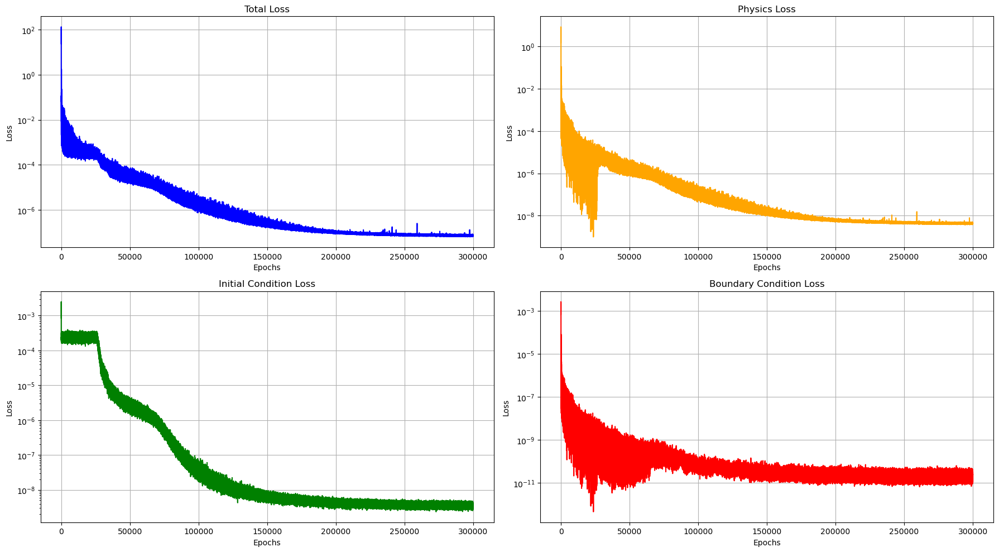

In [10]:
fig, axs = plt.subplots(2, 2, figsize=(18, 10))

# Total Loss
axs[0, 0].plot(epochs_range, total_loss_history, color='blue')
axs[0, 0].set_title('Total Loss')
axs[0, 0].set_xlabel('Epochs')
axs[0, 0].set_ylabel('Loss')
axs[0, 0].grid(True)
axs[0, 0].set_yscale("log")

# Physics Loss
axs[0, 1].plot(epochs_range, physics_loss_history, color='orange')
axs[0, 1].set_title('Physics Loss')
axs[0, 1].set_xlabel('Epochs')
axs[0, 1].set_ylabel('Loss')
axs[0, 1].grid(True)
axs[0, 1].set_yscale("log")

# Initial Condition Loss
axs[1, 0].plot(epochs_range, initial_condition_loss_history, color='green')
axs[1, 0].set_title('Initial Condition Loss')
axs[1, 0].set_xlabel('Epochs')
axs[1, 0].set_ylabel('Loss')
axs[1, 0].grid(True)
axs[1, 0].set_yscale("log")

# Boundary Condition Loss
axs[1, 1].plot(epochs_range, boundary_condition_loss_history, color='red')
axs[1, 1].set_title('Boundary Condition Loss')
axs[1, 1].set_xlabel('Epochs')
axs[1, 1].set_ylabel('Loss')
axs[1, 1].grid(True)
axs[1, 1].set_yscale("log")

plt.tight_layout()
plt.show()

In [11]:
def view_metrics(arr):
    mean = np.mean(arr)
    std = np.std(arr)
    mn = np.min(arr)
    mx = np.max(arr)
    
    fig = go.Figure(data=[go.Table(header=dict(values=['Mean', 'Standard Deviation', 'Min', 'Max']),
                 cells=dict(values=[[f"{mean:.5f}"], [f"{std:.5f}"], [f"{mn:.5f}"], [f"{mx:.5f}"]]))
                     ])
    fig.update_layout(width=500, height=300)
    fig.show()

In [12]:
Nx = 500
Ny = 500
Nt = 500

x_values = np.linspace(x_min, x_max, Nx)
y_values = np.linspace(y_min, y_max, Ny)
t_values = np.linspace(t_min, t_max, Nt)

In [13]:
x_values_torch = torch.from_numpy(x_values).float()
y_values_torch = torch.from_numpy(y_values).float()
t_values_torch = torch.from_numpy(t_values).float()

x_grid, y_grid, t_grid = torch.meshgrid(x_values_torch, y_values_torch, t_values_torch, indexing="ij")

x_flat = torch.reshape(x_grid, [-1])
y_flat = torch.reshape(y_grid, [-1])
t_flat = torch.reshape(t_grid, [-1])

batch_size = 100000
psi_real_list = []
psi_img_list = []

model.eval()
with torch.no_grad():
    for i in range(0, x_flat.shape[0], batch_size):
        x_batch = x_flat[i:i+batch_size]
        y_batch = y_flat[i:i+batch_size]
        t_batch = t_flat[i:i+batch_size]
        psi_real, psi_img = model((x_batch, y_batch, t_batch))
        psi_real_list.append(psi_real.cpu())
        psi_img_list.append(psi_img.cpu())

# psi_real_pinn, psi_img_pinn = model((x_flat, y_flat, t_flat))

# psi_real_pinn = torch.reshape(psi_real_pinn, (Nx, Ny, Nt))
# psi_img_pinn = torch.reshape(psi_img_pinn, (Nx, Ny, Nt))

In [14]:
psi_real_pinn = torch.cat(psi_real_list).reshape(Nx, Ny, Nt).numpy()
psi_img_pinn = torch.cat(psi_img_list).reshape(Nx, Ny, Nt).numpy()

In [15]:
skip = 5

x_ds = x_values[::skip]
y_ds = y_values[::skip]
t_ds = t_values[::skip]

X, Y, T = np.meshgrid(x_ds, y_ds, t_ds, indexing='ij')

real_ds = psi_real_pinn[::skip, ::skip, ::skip]
imag_ds = psi_img_pinn[::skip, ::skip, ::skip]

psi_sq_ds = real_ds ** 2 + imag_ds ** 2

fig = go.Figure(data=go.Volume(
	x=X.flatten(),
    y=Y.flatten(),
    z=T.flatten(),
    value=psi_sq_ds.flatten(),
    isomin=0,
    isomax=np.max(psi_sq_ds),
    opacity=0.1,
    surface_count=25,
    colorscale='Viridis',
))

fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='T',
    ),
    title='Probability Density',
    margin=dict(l=0, r=0, b=0, t=50),
    width=720,
    height=720
)

fig.show()

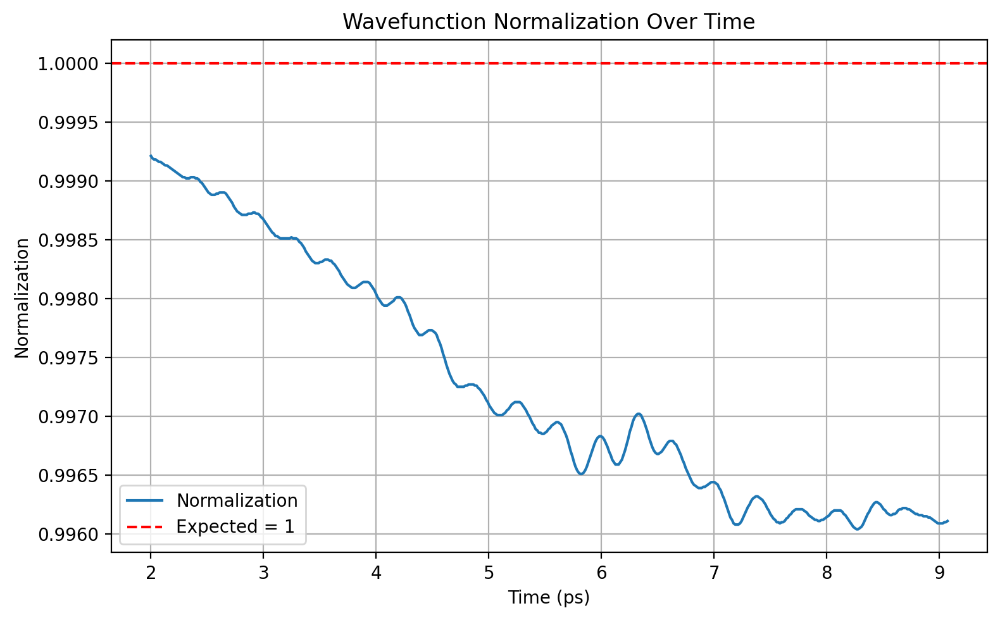

In [16]:
from scipy.integrate import simpson

norms = []

for i in range(500):
	psi_sq_i = psi_real_pinn[:, :, i] ** 2 + psi_img_pinn[:, :, i] ** 2
	norms_x = []

	for j in range(500):
		norm_x = simpson(psi_sq_i[:, j], x=x_values)
		norms_x.append(norm_x)

	normalization = simpson(norms_x, x=y_values)
	norms.append(np.round(normalization, 5))
  
fig, ax = plt.subplots(figsize=(8, 5), dpi=200)

ax.plot(t_values, norms, '-', label='Normalization')
ax.axhline(1.0, color='red', linestyle='--', label='Expected = 1')

ax.yaxis.get_major_formatter().set_useOffset(False)

ax.set_xlabel('Time (ps)')
ax.set_ylabel('Normalization')
ax.set_title('Wavefunction Normalization Over Time')
ax.legend()
ax.grid(True)

plt.tight_layout()
plt.show()

In [17]:
# from scipy import special

# psi_pinn = psi_real_pinn + 1j * psi_img_pinn

# def quantum_center(t):
#     if t < t1:
#         return x0
#     elif t < t1 + (x1 - x0) / vQD:
#         return x0 + vQD * (t - t1)
#     else:
#         return x1
    
# def psi_x_n(x, t, n):
#     A = 1 / np.sqrt((2 ** n) * special.factorial(n))
#     B = ((m * omega) / (np.pi * hbar)) ** (1/4)
#     C = np.exp((-m * omega * (x - quantum_center(t)) ** 2) / (2 * hbar))
#     D = special.eval_hermite(n, np.sqrt((m * omega) / hbar) * (x - quantum_center(t)))
#     return A * B * C * D

# def psi_x_t_n(x, t, n):
#     A = psi_x_n(x, t, n)
#     En = (n + (1/2)) * hbar * omega
#     B = np.exp(-(1j * En * t) / hbar)
#     return A * B

# lambda0, lambda1 = [], []
# lambda2, lambda3 = [], []
# lambda4, lambda5 = [], []

# for i, t in enumerate(t_values):
#     psi = psi_pinn[:, i]
    
#     psi0_t = psi_x_t_n(x_values, t, 0)
#     psi1_t = psi_x_t_n(x_values, t, 1)
#     psi2_t = psi_x_t_n(x_values, t, 2)
#     psi3_t = psi_x_t_n(x_values, t, 3)
#     psi4_t = psi_x_t_n(x_values, t, 4)
#     psi5_t = psi_x_t_n(x_values, t, 5)
    
#     lambda0_i = simpson(psi * np.conj(psi0_t), x=x_values)
#     lambda1_i = simpson(psi * np.conj(psi1_t), x=x_values)
#     lambda2_i = simpson(psi * np.conj(psi2_t), x=x_values)
#     lambda3_i = simpson(psi * np.conj(psi3_t), x=x_values)
#     lambda4_i = simpson(psi * np.conj(psi4_t), x=x_values)
#     lambda5_i = simpson(psi * np.conj(psi5_t), x=x_values)
    
#     lambda0.append(np.abs(lambda0_i) ** 2)
#     lambda1.append(np.abs(lambda1_i) ** 2)
#     lambda2.append(np.abs(lambda2_i) ** 2)
#     lambda3.append(np.abs(lambda3_i) ** 2)
#     lambda4.append(np.abs(lambda4_i) ** 2)
#     lambda5.append(np.abs(lambda5_i) ** 2)

# plt.figure(figsize=(8,5), dpi=200)
# plt.plot(t_values, lambda0, label='ground state')
# plt.plot(t_values, lambda1, label='first excited')
# plt.plot(t_values, lambda2, label='second excited')
# plt.plot(t_values, lambda3, label='third excited')
# plt.plot(t_values, lambda4, label='forth excited')
# plt.plot(t_values, lambda5, label='fifth excited')
# plt.xlabel("Time (ps)")
# plt.ylabel("Probability weight")
# plt.title("Time-dependent weights of excited states")
# plt.legend()
# plt.grid(True)
# plt.show()
